### Préparer son environnement

Je suppose que tout est bien installé sur votre machine (cf [ici](https://docs.python.org/fr/3.9/installing/index.html) pour des explications). On commence donc par charger les bibliothèques Python dont on a besoin :

In [1]:
import numpy as np               # bibliothèque qui ajoute les tables
import pandas as pd              # bibliothèque qui ajoute les tableaux (tableurs)
import matplotlib.pyplot as plt  # bibliothèque graphique pour tracer des courbes

#import datetime as dt
#import math
#import IPython.display as ds

# commandes magiques Jupyter pour voir les graphiques dans cette page :
%matplotlib inline                           
%config InlineBackend.figure_format = 'retina'

### Récupération des données

In [2]:
prenoms_raw = pd.read_csv("data/dpt2020.csv", sep=";", encoding="utf-8")#, skiprows=[0,1,3], header=None)
prenoms_raw

,sexe,preusuel,annais,dpt,nombre
0,1,_PRENOMS_RARES,1900,02,7
1,1,_PRENOMS_RARES,1900,04,9
2,1,_PRENOMS_RARES,1900,05,8
3,1,_PRENOMS_RARES,1900,06,23
4,1,_PRENOMS_RARES,1900,07,9
...,...,...,...,...,...
3727548,2,ZYA,2018,59,3
3727549,2,ZYA,XXXX,XX,264
3727550,2,ZYNA,2013,93,3
3727551,2,ZYNA,XXXX,XX,59


In [3]:
population_raw = pd.read_excel('data/base-pop-historiques-1876-2019.xlsx', header=5)
population_raw

,CODGEO,REG,DEP,LIBGEO,PMUN19,PMUN18,PMUN17,PMUN16,PMUN15,PMUN14,...,PTOT1926,PTOT1921,PTOT1911,PTOT1906,PTOT1901,PTOT1896,PTOT1891,PTOT1886,PTOT1881,PTOT1876
0,01001,84,01,L'Abergement-Clémenciat,779,771,776,767,767,767,...,543.0,566.0,560.0,629.0,637.0,572.0,594.0,622.0,605.0,604.0
1,01002,84,01,L'Abergement-de-Varey,256,253,248,243,241,239,...,253.0,256.0,291.0,323.0,357.0,391.0,421.0,486.0,490.0,484.0
2,01004,84,01,Ambérieu-en-Bugey,14134,14204,14035,14081,14127,14022,...,5705.0,4796.0,4334.0,4100.0,4023.0,3548.0,3635.0,3618.0,3396.0,3427.0
3,01005,84,01,Ambérieux-en-Dombes,1751,1720,1689,1671,1619,1627,...,690.0,698.0,805.0,805.0,835.0,852.0,862.0,882.0,879.0,848.0
4,01006,84,01,Ambléon,112,112,111,110,109,109,...,161.0,150.0,159.0,193.0,200.0,206.0,200.0,200.0,213.0,191.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34962,97420,4,974,Sainte-Suzanne,24065,23718,23505,23224,23068,22406,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
34963,97421,4,974,Salazie,7136,7224,7312,7400,7384,7132,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
34964,97422,4,974,Le Tampon,79824,79385,78629,77283,76310,76796,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
34965,97423,4,974,Les Trois-Bassins,7015,7076,7139,7111,7127,7198,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [4]:
population_raw.dtypes

CODGEO       object
REG           int64
DEP          object
LIBGEO       object
PMUN19        int64
PMUN18        int64
PMUN17        int64
PMUN16        int64
PMUN15        int64
PMUN14        int64
PMUN13        int64
PMUN12        int64
PMUN11        int64
PMUN10        int64
PMUN09        int64
PMUN08        int64
PMUN07        int64
PMUN06        int64
PSDC99        int64
PSDC90        int64
PSDC82        int64
PSDC75        int64
PSDC68        int64
PSDC62        int64
PTOT54      float64
PTOT36      float64
PTOT1931    float64
PTOT1926    float64
PTOT1921    float64
PTOT1911    float64
PTOT1906    float64
PTOT1901    float64
PTOT1896    float64
PTOT1891    float64
PTOT1886    float64
PTOT1881    float64
PTOT1876    float64
dtype: object

In [5]:
population_raw_ = population_raw.drop(columns=["CODGEO", "REG"])
departement_population = population_raw_.groupby("DEP").sum()
departement_population

,PMUN19,PMUN18,PMUN17,PMUN16,PMUN15,PMUN14,PMUN13,PMUN12,PMUN11,PMUN10,...,PTOT1926,PTOT1921,PTOT1911,PTOT1906,PTOT1901,PTOT1896,PTOT1891,PTOT1886,PTOT1881,PTOT1876
DEP,,,,,,,,,,,,,,,,,,,,,
01,652432,647634,643350,638425,631877,626127,619497,612191,603827,597341,...,310275.0,309610.0,335271.0,338686.0,343179.0,345516.0,350841.0,357207.0,356980.0,358298.0
02,531345,533316,534490,536136,538659,539734,540020,540843,541256,540458,...,488639.0,421022.0,529783.0,534021.0,535088.0,541058.0,544919.0,555436.0,556284.0,559242.0
03,335975,337171,337988,339384,341613,343062,343431,342911,342729,342908,...,370562.0,370950.0,406291.0,417961.0,422024.0,424378.0,424382.0,424582.0,416759.0,405783.0
04,164308,164068,163915,162565,161799,161588,161916,161241,160959,160149,...,88347.0,91882.0,107231.0,113126.0,115021.0,118142.0,124285.0,129494.0,131899.0,136166.0
05,141220,140698,141284,141107,140916,139883,139279,139554,138605,136971,...,87963.0,89275.0,105083.0,107498.0,109510.0,113229.0,115522.0,122924.0,121787.0,119094.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,1249674,1238581,1228618,1221923,1215390,1205539,1194681,1187081,1180365,1171161,...,283256.0,227220.0,196599.0,178444.0,164962.0,154118.0,143387.0,143028.0,134859.0,129655.0
971,384239,387629,390253,394110,397990,400186,402119,403314,404635,403355,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
972,364508,368783,372594,376480,380877,383911,385551,388364,392291,394173,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


### Nettoyons en supprimant les prenoms non usuels "\_PRENOMS\_RARES" et sans année de naissance ni de département

In [6]:
no_name = prenoms_raw[prenoms_raw.preusuel == "_PRENOMS_RARES"]
prenoms = prenoms_raw.drop(index = no_name.index)

no_date = prenoms[prenoms.annais == "XXXX"]
prenoms = prenoms.drop(index = no_date.index)

# Supprimer les cas non daté suffisent a supprimer les cas sans départements
print(prenoms[prenoms.dpt == "XX"].shape)

prenoms.annais = prenoms.annais.astype(int)
#prenoms.dpt = prenoms.dpt.astype(int)

prenoms

(0, 5)


,sexe,preusuel,annais,dpt,nombre
10885,1,AADIL,1983,84,3
10886,1,AADIL,1992,92,3
10888,1,AAHIL,2016,95,3
10892,1,AARON,1962,75,3
10893,1,AARON,1976,75,3
...,...,...,...,...,...
3727545,2,ZYA,2013,44,4
3727546,2,ZYA,2013,59,3
3727547,2,ZYA,2017,974,3
3727548,2,ZYA,2018,59,3


In [7]:
prenoms[prenoms.preusuel == "MICHEL"]

,sexe,preusuel,annais,dpt,nombre
1196203,1,MICHEL,1900,01,4
1196204,1,MICHEL,1900,03,8
1196205,1,MICHEL,1900,06,16
1196206,1,MICHEL,1900,08,3
1196207,1,MICHEL,1900,09,6
...,...,...,...,...,...
3222197,2,MICHEL,1917,972,3
3222198,2,MICHEL,1923,971,5
3222199,2,MICHEL,1925,972,3
3222200,2,MICHEL,1932,972,4


In [8]:
dep_pop = departement_population.iloc[..., 0].reset_index()
dep_pop

,DEP,PMUN19
0,01,652432
1,02,531345
2,03,335975
3,04,164308
4,05,141220
...,...,...
95,95,1249674
96,971,384239
97,972,364508
98,973,281678


### Carte de la population française en 2019
GeoJson incomplet: il manque les département d'outre-mer

In [9]:
import json

with open("data/departements.geojson") as response:
    departements = json.load(response)

for departement in departements["features"]:
    code = departement["properties"]["code"]
    departement["id"] = code

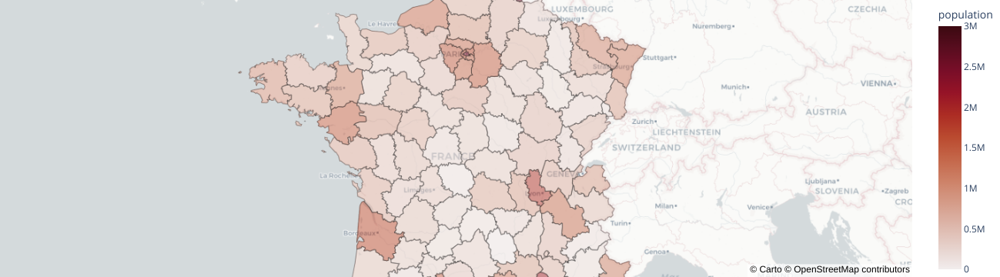

In [10]:
import plotly.express as px

fig = px.choropleth_mapbox(dep_pop, geojson=departements, locations='DEP', color='PMUN19',
                           color_continuous_scale="Amp",
                           range_color=(0, 3000000),
                           mapbox_style="carto-positron",
                           zoom=4.8, center = {"lat": 47, "lon": 2},
                           opacity=0.5,
                           labels={'PMUN19':'population'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

### Carte des Michel de 1917

In [11]:
dpt = ["0" + str(i) for i in range(10)] + [str(i) for i in range(10,96)] + ["971", "972", "973", "974"]

In [12]:
# Affiche les occurences d'un prenom par année (peut importe le sexe)
def occ_name_year(df, name, year):
    df_year = df[df.annais == year]
    return df_year[df_year.preusuel == name].groupby("dpt").sum().drop(columns=["sexe", "annais"]).reset_index()

In [13]:
occ_name_year(prenoms, "THOMAS", 2000)

,dpt,nombre
0,01,35
1,02,110
2,03,71
3,04,15
4,05,19
...,...,...
94,95,203
95,971,61
96,972,61
97,973,10


In [14]:
def plot_occ_name_year(df, name, year):
    df = occ_name_year(df, name, year).set_index("dpt").reindex(dpt, fill_value=0).reset_index()
    print(df)
    fig = px.choropleth_mapbox(df, geojson=departements, locations='dpt', color='nombre',
                           color_continuous_scale="Amp",
                           range_color=(0, max(1, df.nombre.max())),
                           mapbox_style="carto-positron",
                           zoom=4.8, center = {"lat": 47, "lon": 2},
                           opacity=0.5,
                           labels={'dpt':'departement', 'nombre':'occurence'}
                          )
    fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
    fig.show()

    dpt  nombre
0    00       0
1    01      11
2    02      28
3    03      13
4    04       0
..  ...     ...
95   95      70
96  971      10
97  972      13
98  973      11
99  974      84

[100 rows x 2 columns]


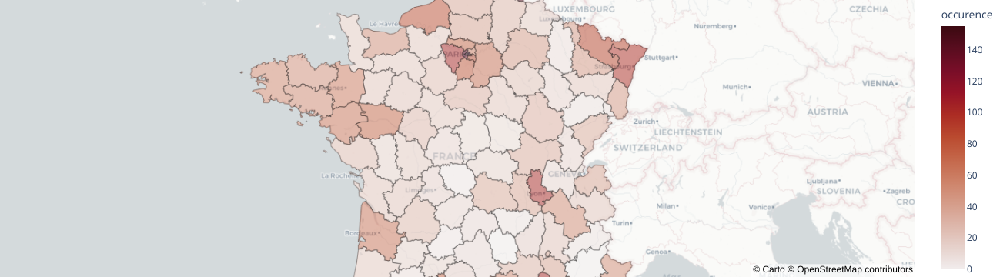

In [15]:
plot_occ_name_year(prenoms, "GUILLAUME", 2000)

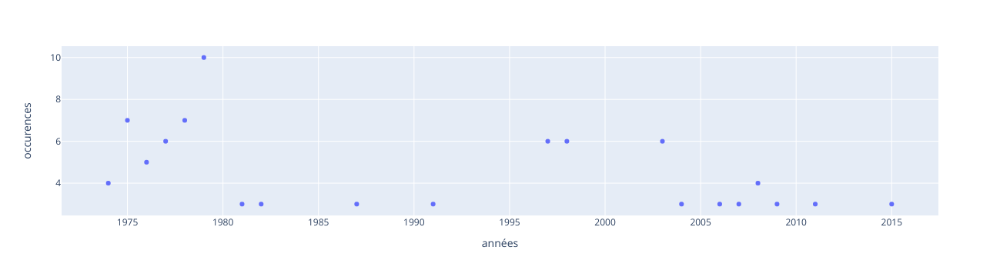

In [16]:
def plot_name_occurence_france(name):
    occurences = prenoms[prenoms.preusuel == name].drop(columns='sexe')
    occurences = occurences.groupby('annais').sum().reset_index()
    fig = px.scatter(occurences, y='nombre', x='annais', labels={"nombre":"occurences", "annais": "années"})
    fig.show()
plot_name_occurence_france("GWELTAZ")

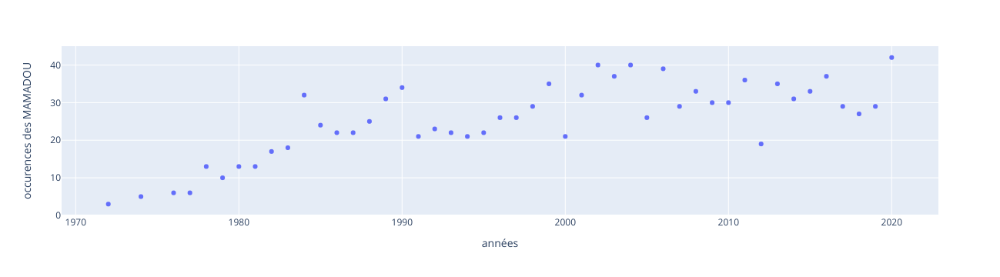

In [17]:
def plot_name_occurence_departement(name, departement):
    occurences = prenoms[prenoms.preusuel == name].drop(columns='sexe')
    fig = px.scatter(occurences[occurences.dpt == departement], y='nombre', x='annais', labels={"nombre":f"occurences des {name}", "annais": "années"})
    fig.show()
plot_name_occurence_departement('MAMADOU', '93')

In [18]:
prenoms[prenoms.dpt == "20"]

,sexe,preusuel,annais,dpt,nombre
11225,1,AARON,2008,20,3
11657,1,AARON,2013,20,4
11750,1,AARON,2014,20,5
11842,1,AARON,2015,20,5
11936,1,AARON,2016,20,5
...,...,...,...,...,...
3724990,2,ZOÉ,2008,20,3
3725088,2,ZOÉ,2009,20,5
3725183,2,ZOÉ,2010,20,7
3725365,2,ZOÉ,2012,20,5


In [19]:
chomage_region_to_drop = [6, 15, 20, 24, 27, 34, 38, 43, 46, 51, 54, 59, 65, 70, 75, 81, 90, 94, 103, 108, 114]
chomage_region_to_drop = [i - 4 for i in chomage_region_to_drop]
toto = [2,11,16,20,23,30,34,39,42,47,50,55,61,66,71,77,86,90,99,104,110, 120]
chomage_region_to_drop == toto

False

In [20]:
chomage_raw = pd.read_excel('data/irsoceds2013_T302.xls', header=2)
chomage_raw

,DATE,1982,1983,1984,1985,1986,1987,1988,1989,1990,...,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014
0,Niveau géographique,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,France métropolitaine,6.6,6.9,8.1,8.5,8.6,8.7,8.4,7.8,7.6,...,8.5,8.5,7.7,7.1,8.7,8.9,8.8,9.4,9.9,9.9
2,11-Île-de-France,5.4,5.4,6.2,6.8,7.1,7.2,7.1,6.6,6.3,...,8.3,8.0,7.2,6.3,7.6,7.9,7.9,8.2,8.7,8.8
3,75-Paris,6.1,6.4,7.1,7.7,8.1,8.3,8.5,8.2,8.6,...,8.9,8.4,7.6,6.7,7.8,8.0,7.8,8.0,8.3,8.3
4,77-Seine-et-Marne,5.0,5.1,5.9,6.2,6.3,6.5,6.3,5.7,5.2,...,7.1,6.8,6.0,5.4,6.8,7.0,7.0,7.5,8.0,8.1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
116,84-Vaucluse,6.7,7.9,9.4,9.9,9.8,9.5,9.1,8.6,9.1,...,9.9,10.0,9.5,8.7,10.4,10.8,11.3,12.0,12.6,12.7
117,94-Corse,7.8,9.1,10.0,10.1,10.4,10.4,9.7,9.3,9.9,...,9.2,9.1,8.4,7.6,8.3,8.6,8.8,9.2,9.9,10.3
118,2A-Corse-du-Sud,6.9,7.9,8.8,9.3,9.1,9.4,8.9,8.7,9.3,...,8.6,8.3,7.6,7.0,7.6,8.0,8.2,8.7,9.2,9.4
119,2B-Haute-Corse,8.5,10.3,11.2,11.0,11.5,11.3,10.4,9.9,10.4,...,9.8,10.0,9.2,8.2,8.9,9.3,9.5,9.8,10.7,11.2


In [21]:
chomage_raw = chomage_raw.drop(index=toto)
chomage_raw

,DATE,1982,1983,1984,1985,1986,1987,1988,1989,1990,...,2005,2006,2007,2008,2009,2010,2011,2012,2013,2014
0,Niveau géographique,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,France métropolitaine,6.6,6.9,8.1,8.5,8.6,8.7,8.4,7.8,7.6,...,8.5,8.5,7.7,7.1,8.7,8.9,8.8,9.4,9.9,9.9
3,75-Paris,6.1,6.4,7.1,7.7,8.1,8.3,8.5,8.2,8.6,...,8.9,8.4,7.6,6.7,7.8,8.0,7.8,8.0,8.3,8.3
4,77-Seine-et-Marne,5.0,5.1,5.9,6.2,6.3,6.5,6.3,5.7,5.2,...,7.1,6.8,6.0,5.4,6.8,7.0,7.0,7.5,8.0,8.1
5,78-Yvelines,3.7,3.7,4.4,5.0,4.9,5.1,5.0,4.5,4.2,...,6.6,6.3,5.8,5.1,6.3,6.6,6.4,6.7,7.1,7.3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
115,83-Var,8.0,8.7,10.2,11.1,11.0,10.7,10.3,10.0,10.0,...,10.1,9.9,9.2,8.4,9.9,10.0,10.2,10.7,11.1,11.3
116,84-Vaucluse,6.7,7.9,9.4,9.9,9.8,9.5,9.1,8.6,9.1,...,9.9,10.0,9.5,8.7,10.4,10.8,11.3,12.0,12.6,12.7
117,94-Corse,7.8,9.1,10.0,10.1,10.4,10.4,9.7,9.3,9.9,...,9.2,9.1,8.4,7.6,8.3,8.6,8.8,9.2,9.9,10.3
118,2A-Corse-du-Sud,6.9,7.9,8.8,9.3,9.1,9.4,8.9,8.7,9.3,...,8.6,8.3,7.6,7.0,7.6,8.0,8.2,8.7,9.2,9.4


In [22]:
chomage_raw.DATE = chomage_raw.DATE.str[:2] # works only because no DOM TOM
chomage_raw = chomage_raw.rename(columns={"DATE": "dpt"})
chomage_raw.dpt

0      Ni
1      Fr
3      75
4      77
5      78
       ..
115    83
116    84
117    94
118    2A
119    2B
Name: dpt, Length: 99, dtype: object

In [23]:
chomage_raw.iloc[...,:2]

,dpt,1982
0,Ni,NaN
1,Fr,6.6
3,75,6.1
4,77,5.0
5,78,3.7
...,...,...
115,83,8.0
116,84,6.7
117,94,7.8
118,2A,6.9


In [24]:
chomage_raw = chomage_raw.set_index("dpt")
chomage_raw.columns = chomage_raw.columns.astype(int)
chomage_raw = chomage_raw.reset_index()
chomage_raw.columns

Index(['dpt',  1982,  1983,  1984,  1985,  1986,  1987,  1988,  1989,  1990,
        1991,  1992,  1993,  1994,  1995,  1996,  1997,  1998,  1999,  2000,
        2001,  2002,  2003,  2004,  2005,  2006,  2007,  2008,  2009,  2010,
        2011,  2012,  2013,  2014],
      dtype='object')

In [25]:
def plot_chomage_year(df, year):
    fig = px.choropleth_mapbox(df, geojson=departements, locations='dpt', color=year,
                           color_continuous_scale="Amp",
                           range_color=(0, 16),
                           mapbox_style="carto-positron",
                           zoom=4.8, center = {"lat": 47, "lon": 2},
                           opacity=0.5,
                           labels={'dpt':'departement', year:'chomage'}
                          )
    fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
    fig.show()

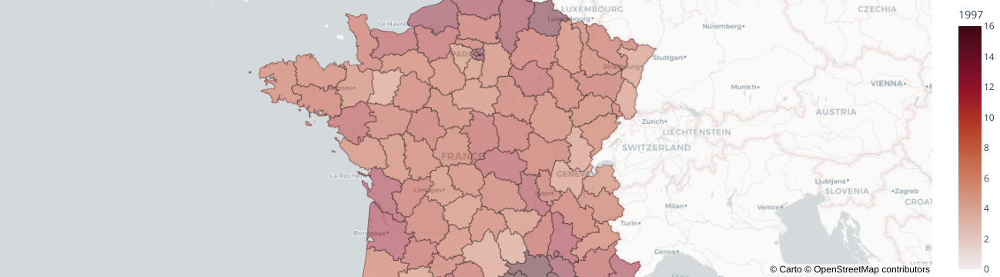

In [26]:
plot_chomage_year(chomage_raw, 1997)

In [27]:
xls = pd.ExcelFile('data/irsoceds2013_T102.xls')
emploi_region_to_drop = [i for i in chomage_region_to_drop]
def read_sheet(sheet):    
    emploi_raw = pd.read_excel(xls, sheet, header=4).drop(index=[0, 1, 120] + emploi_region_to_drop)
    emploi_raw.DATE = emploi_raw.DATE.str[:2]
    emploi_raw = emploi_raw.rename(columns={"DATE": "dpt"}).set_index("dpt")
    emploi_raw.columns = emploi_raw.columns.str[6:10].astype(int)
    return emploi_raw.reset_index()
all_emploi = read_sheet('T - TAZ')#[['dpt', 1990]].set_index("dpt")#.reindex(dpt, fill_value=0)
all_emploi

,dpt,1989,1990,1991,1992,1993,1994,1995,1996,1997,...,2004,2005,2006,2007,2008,2009,2010,2011,2012,2013
0,75,678.0,738.0,770.0,848.0,922.0,965.0,1094.0,1154.0,1173.0,...,1041.0,1144.0,1061.0,1134.0,793.0,777.0,697.0,629.0,663.0,698.0
1,77,1906.0,2015.0,2050.0,2187.0,2303.0,2328.0,2548.0,2606.0,2552.0,...,1855.0,1839.0,1859.0,1778.0,1725.0,1752.0,1717.0,1681.0,1803.0,1885.0
2,78,905.0,988.0,1007.0,1108.0,1196.0,1236.0,1386.0,1447.0,1455.0,...,1035.0,1113.0,1101.0,1089.0,1005.0,983.0,943.0,970.0,933.0,985.0
3,91,1225.0,1340.0,1376.0,1477.0,1578.0,1619.0,1798.0,1867.0,1857.0,...,1145.0,1070.0,904.0,781.0,631.0,557.0,549.0,463.0,466.0,508.0
4,92,5.0,6.0,7.0,8.0,9.0,10.0,12.0,14.0,15.0,...,16.0,9.0,48.0,38.0,30.0,35.0,37.0,40.0,32.0,29.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
92,83,4325.0,3962.0,3961.0,3788.0,3800.0,3747.0,3855.0,3955.0,4270.0,...,4386.0,4261.0,4272.0,3846.0,3701.0,3713.0,3649.0,3538.0,3588.0,3582.0
93,84,5495.0,5530.0,5323.0,5202.0,5301.0,5880.0,5574.0,5946.0,6233.0,...,6422.0,5771.0,5362.0,4943.0,4684.0,4500.0,4411.0,4663.0,4549.0,5158.0
94,94,2479.0,2176.0,2213.0,2359.0,2419.0,2160.0,2014.0,1961.0,1904.0,...,1818.0,1871.0,1923.0,1499.0,1711.0,1626.0,1628.0,1790.0,1973.0,2038.0
95,2A,318.0,301.0,346.0,401.0,416.0,393.0,385.0,397.0,408.0,...,401.0,415.0,419.0,418.0,429.0,379.0,383.0,408.0,417.0,427.0


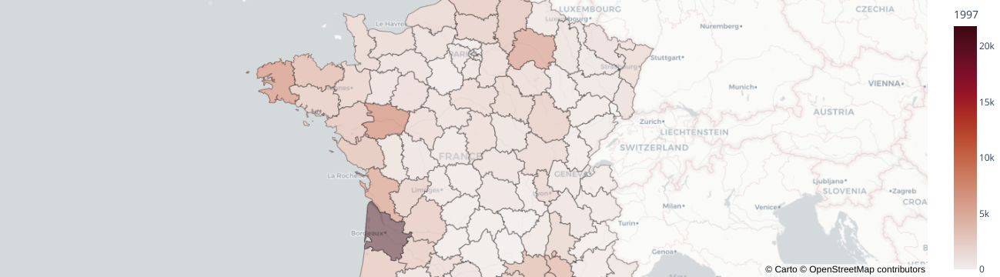

In [28]:
def plot_emploi_sheet_year(sheet, year):
    df = read_sheet(sheet).loc[:,['dpt', year]]
    fig = px.choropleth_mapbox(df, geojson=departements, locations='dpt', color=year,
                           color_continuous_scale="Amp",
                           range_color=(0, max(1, df[year].max())),
                           mapbox_style="carto-positron",
                           zoom=4.8, center = {"lat": 47, "lon": 2},
                           opacity=0.5,
                           labels={'dpt':'departement', year:'emploi'}
                          )
    fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
    fig.show()
plot_emploi_sheet_year('T - TAZ', 1997)

In [29]:
df = pd.DataFrame()
df['sheet'] = xls.sheet_names
df['secteurs'] = [pd.read_excel(xls, secteur).iloc[1,0] for secteur in xls.sheet_names]
df

,sheet,secteurs
0,T - T,NA38 : Tous secteurs
1,T - TAZ,NA38 : TAZ-Agriculture
2,T - TBE,NA38 : TBE-Industrie
3,T - TBEC1,NA38 : TBEC1-Fabrication de denrées alimentair...
4,T - TBEC2,NA38 : TBEC2-Cokéfaction et raffinage
...,...,...
139,TF - TOQ,NA38 : TOQ-Tertiaire non marchand
140,TF - TOQOQOZ,NA38 : TOQOQOZ-Administration publique
141,TF - TOQOQPZ,NA38 : TOQOQPZ-Enseignement
142,TF - TOQOQQA,NA38 : TOQOQQA-Activités pour la santé humaine


In [30]:
pd.read_excel(xls, 'T - T').iloc[1,0]

'NA38 : Tous secteurs'

In [31]:
dict_ = {secteur : pd.read_excel(xls, secteur).iloc[1,0].split('-')[1] if len(secteur) > 6 else
         pd.read_excel(xls, secteur).iloc[1,0][7:] for secteur in xls.sheet_names}

In [32]:
prenoms[prenoms.preusuel.str.lower().str.startswith('é')]

,sexe,preusuel,annais,dpt,nombre
408327,1,ÉDEN,2012,93,3
408328,1,ÉDEN,2013,13,4
408329,1,ÉDEN,2013,59,4
408330,1,ÉDEN,2013,69,3
408331,1,ÉDEN,2013,75,3
...,...,...,...,...,...
2420721,2,ÉVELYNE,1959,75,7
2420968,2,ÉVY,2017,42,3
2420969,2,ÉVY,2018,57,3
2420970,2,ÉVY,2018,69,4


In [33]:
lowered = prenoms
lowered.preusuel = lowered.preusuel.str.lower()
lowered

,sexe,preusuel,annais,dpt,nombre
10885,1,aadil,1983,84,3
10886,1,aadil,1992,92,3
10888,1,aahil,2016,95,3
10892,1,aaron,1962,75,3
10893,1,aaron,1976,75,3
...,...,...,...,...,...
3727545,2,zya,2013,44,4
3727546,2,zya,2013,59,3
3727547,2,zya,2017,974,3
3727548,2,zya,2018,59,3


In [34]:
lowered[lowered.preusuel.str.startswith('fran')].groupby('preusuel').sum().tail(60)

,sexe,annais,nombre
preusuel,,,
frances,12,11656,20
francesa,12,11610,20
francesca,652,648441,1531
francesca-maria,8,8052,14
francesco,282,556873,1459
francescu,19,38151,127
francescu-maria,6,12097,19
franceska,4,4010,6
francette,1742,1696027,5550


In [35]:
hommes = { key: val for key, val in dict_.items() if key.startswith('TF')}

In [36]:
prenoms.index

Int64Index([  10885,   10886,   10888,   10892,   10893,   10894,   10895,
              10896,   10897,   10898,
            ...
            3727539, 3727540, 3727542, 3727543, 3727544, 3727545, 3727546,
            3727547, 3727548, 3727550],
           dtype='int64', length=3668274)

In [37]:
prenoms.annais = prenoms.annais.astype(int)

In [38]:
prnm_dpt_year_gender = prenoms.set_index(['sexe', 'dpt', 'annais', 'preusuel'])

In [39]:
prnm_dpt_year_gender.sort_index(inplace=True)

In [40]:
prnm_dpt_year_gender['percentage'] = 100 * prnm_dpt_year_gender['nombre'] / prnm_dpt_year_gender.groupby(level=[0,1,2])['nombre'].sum()

In [41]:
prnm_dpt_year_gender.index = prnm_dpt_year_gender.index.set_levels(prnm_dpt_year_gender.index.levels[1].astype(int), level=1)

In [42]:
prnm_dpt_year_gender

nombre  percentage
sexe dpt annais preusuel                     
1    1   1900   adrien          8    0.598802
                aime           10    0.748503
                albert         22    1.646707
                alexandre      10    0.748503
                alfred          8    0.598802
...                           ...         ...
2    974 2020   éléanore        3    0.083752
                éléna           5    0.139587
                émy             6    0.167504
                énora           3    0.083752
                éva             4    0.111669

[3668274 rows x 2 columns]

In [43]:
def read_sheet(xls, sheet):    
    to_drop = [0, 1, 2, 11, 16, 20, 23, 30, 34, 39, 42, 47,
        50, 55, 61, 66, 71, 77, 86, 90, 99, 104, 110, 118, 119, 120]
    emploi_raw = pd.read_excel(xls, sheet, header=4).drop(index=to_drop)
    emploi_raw.DATE = emploi_raw.DATE.str[:2]
    emploi_raw = emploi_raw.rename(columns={"DATE": "dpt"})
    emploi_raw.iat[-1,0] = "20"
    emploi_raw.dpt = emploi_raw.dpt.astype(int)
    emploi_raw.set_index("dpt", inplace=True)
    emploi_raw.columns = emploi_raw.columns.str[6:10].astype(int)
    return emploi_raw

In [44]:
def read_all_sheet_emploi(xls):
    dfs = []
    for name in xls.sheet_names[48:]:
        df = read_sheet(xls, name)
        
        gender, code = name.split(' - ')
        gender_code = 1 if gender == 'TH' else 2
        
        df = pd.concat([
            df[s].to_frame().assign(annee=s)
            .set_index('annee', append=True)
            .rename(columns={s:'nombre'})
        for s in df])
        
        df['sexe'] = gender_code
        df['categorie'] = code
        df.set_index(['sexe', 'categorie'], append=True, inplace=True)
        dfs.append(df.reorder_levels(['sexe', 'dpt', 'annee', 'categorie']))

    return pd.concat(dfs).sort_index()

all_emplois = read_all_sheet_emploi(xls)

In [45]:
categories = list(all_emplois.index.unique(level='categorie'))

In [46]:
unique_categories = []

for cat in categories:
    if all(oth == cat or (not oth.startswith(cat)) for oth in categories):
        unique_categories.append(cat)

In [47]:
def compute_percentage(df, groupby_level, col):
    return 100 * df[col] / df.groupby(level=groupby_level)[col].sum()

In [48]:
base_cat_all_emplois_gdr = all_emplois.loc[(slice(None), slice(None), slice(None), unique_categories), :].copy()

In [49]:
base_cat_all_emplois_gdr['percentage'] = compute_percentage(base_cat_all_emplois_gdr, [0, 1, 2], 'nombre')

In [50]:
base_cat_all_emplois_gdr

nombre  percentage
sexe dpt annee categorie                     
1    1   1989  TAZ          711.0    0.813939
               TBEC1       3550.0    4.063970
               TBEC2          3.0    0.003434
               TBEC3CI      387.0    0.443030
               TBEC3CJ      857.0    0.981077
...                           ...         ...
2    95  2013  TGURUUZ        0.0    0.000000
               TOQOQOZ    28510.0   15.833259
               TOQOQPZ    18586.0   10.321886
               TOQOQQA    17340.0    9.629909
               TOQOQQB    18285.0   10.154723

[180500 rows x 2 columns]

In [51]:
base_cat_all_emplois_gdr = base_cat_all_emplois_gdr.sort_values('nombre', ascending=False).sort_index(level=[0,1,2])

In [52]:
mixed_all_cat = base_cat_all_emplois_gdr.groupby(level=['dpt', 'annee', 'categorie']).sum()

In [53]:
mixed_all_cat

nombre  percentage
dpt annee categorie                     
1   1989  TAZ          936.0    1.180603
          TBEC1       5668.0    7.515505
          TBEC2          3.0    0.003434
          TBEC3CI      548.0    0.705399
          TBEC3CJ     1300.0    1.702998
...                      ...         ...
95  2013  TGURUUZ        0.0    0.000000
          TOQOQOZ    46894.0   24.824617
          TOQOQPZ    27526.0   14.694315
          TOQOQQA    22280.0   12.045994
          TOQOQQB    22087.0   12.014228

[90250 rows x 2 columns]

In [54]:
mixed_all_cat['percentage'] = compute_percentage(mixed_all_cat, [0, 1], 'nombre')

In [55]:
mixed_all_cat

nombre  percentage
dpt annee categorie                     
1   1989  TAZ          936.0    0.629383
          TBEC1       5668.0    3.811266
          TBEC2          3.0    0.002017
          TBEC3CI      548.0    0.368485
          TBEC3CJ     1300.0    0.874144
...                      ...         ...
95  2013  TGURUUZ        0.0    0.000000
          TOQOQOZ    46894.0   12.195242
          TOQOQPZ    27526.0    7.158405
          TOQOQQA    22280.0    5.794131
          TOQOQQB    22087.0    5.743940

[90250 rows x 2 columns]

In [56]:
srt_prn_dpt_year_gnd = prnm_dpt_year_gender.loc[(slice(96),),:].sort_values('nombre', ascending=False).sort_index()

In [57]:
def group_val_by_idx_lvl(srt_df, reindex, lvl):
    return {name: group['percentage'].rename(name).droplevel(lvl).reindex(reindex, fill_value=0) for name, group in srt_df.groupby(level=lvl)}

In [58]:
def group_val_by_idx_lvl_gdr(srt_df_gdr, gdr, reindex, lvl):
    srt_df = srt_df_gdr.loc[(gdr, slice(None), slice(None), slice(None))]
    return group_val_by_idx_lvl(srt_df, reindex, lvl)

In [59]:
all_emplois

nombre
sexe dpt annee categorie         
1    1   1989  T          87353.0
               TAZ          711.0
               TBE        36759.0
               TBEC1       3550.0
               TBEC2          3.0
...                           ...
2    95  2013  TOQ        82721.0
               TOQOQOZ    28510.0
               TOQOQPZ    18586.0
               TOQOQQA    17340.0
               TOQOQQB    18285.0

[228000 rows x 1 columns]

In [60]:
cat_index = base_cat_all_emplois_gdr.index.droplevel(['categorie', 'sexe']).unique()

In [61]:
all_cat_dict_male =  group_val_by_idx_lvl_gdr(base_cat_all_emplois_gdr, 1, cat_index, 'categorie')
all_cat_dict_female = group_val_by_idx_lvl_gdr(base_cat_all_emplois_gdr, 2, cat_index, 'categorie')

In [62]:
all_prn_dict_male = group_val_by_idx_lvl_gdr(srt_prn_dpt_year_gnd, 1, cat_index, 'preusuel')
all_prn_dict_female = group_val_by_idx_lvl_gdr(srt_prn_dpt_year_gnd, 2, cat_index, 'preusuel')

In [63]:
all_cat_dict_mixed = group_val_by_idx_lvl(mixed_all_cat, cat_index, 'categorie')

In [64]:
def get_corr_dpt_cat_name(all_cat_dict, all_prn_dict, dpt, cat, name):
    
    cat_dpt = all_cat_dict[cat].loc[dpt]
    prn_dpt = all_prn_dict[name].loc[dpt]
    
    return pd.DataFrame(data=[cat_dpt, prn_dpt]).T.corr().loc[cat, name]
    

In [65]:
get_corr_dpt_cat_name(all_cat_dict_mixed, all_prn_dict_male, 75, 'TAZ', 'adrien')

0.18927810262658012

In [66]:
def get_corr_all_dpt_cat_name(all_cat_dict, all_prn_dict, cat, name):
    # Pour chaque département de la métropole
    return {i: get_corr_dpt_cat_name(all_cat_dict, all_prn_dict, i, cat, name) for i in range(1, 96)}

In [67]:
get_corr_all_dpt_cat_name(all_cat_dict_mixed, all_prn_dict_male, 'TAZ', 'adrien')

{1: 0.09645426012989931,
 2: 0.6446920735459706,
 3: 0.6318454680491885,
 4: 0.6795570638272634,
 5: 0.6758723366943796,
 6: 0.8009435562547,
 7: 0.6888156638446311,
 8: 0.437041683664482,
 9: 0.3571145211951042,
 10: -0.28182197295877176,
 11: 0.5717891676601476,
 12: 0.15344256726331204,
 13: 0.8992667453797918,
 14: 0.004179209989335014,
 15: 0.5129344258973793,
 16: 0.5148619425002784,
 17: 0.612444628654588,
 18: 0.4189624568020967,
 19: 0.2793972517089615,
 20: 0.7394753319053483,
 21: -0.24194270875432505,
 22: 0.5844605692021471,
 23: 0.3169268683875494,
 24: 0.7276639702141405,
 25: -0.4014974029687853,
 26: 0.3946679559562911,
 27: 0.6227887419949003,
 28: -0.1675344354036068,
 29: 0.5272438796106,
 30: 0.7766615269172658,
 31: 0.38139697763125924,
 32: -0.005686246509297233,
 33: 0.9104417287524538,
 34: 0.8682781950329309,
 35: 0.2618332522973538,
 36: 0.7067499513480575,
 37: 0.7809637438533487,
 38: 0.48857127647181836,
 39: -0.5820519430927535,
 40: 0.70780977881293,
 41